<a href="https://colab.research.google.com/github/reapbenefit/easyreport/blob/main/pothole_detection/Pothole_YOLOv5_Train.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [ ]:
#variables
github_repo = "github.com/reapbenefit/easyreport.git"
req = "/content/easyreport/pothole_detection/requirements.txt"
dataset = "/content/easyreport/pothole_detection/data/images_roboflow.zip"
datayaml = "/content/data.yaml"
customyolo = "/content/easyreport/pothole_detection/models/custom_yolov5s.yaml"
yolo_path = "/content/easyreport/pothole_detection"
test_folder = "/content/test/images"

# clone repo
from getpass import getpass
uname = getpass('Username')
ename = getpass('Email ID:')
password = getpass('Password:')
!git clone https://$uname:$password@$github_repo

# install dependencies as necessary
!pip install -qr {req}  # install dependencies (ignore errors)

import torch
from zipfile import ZipFile
from IPython.display import Image, clear_output  # to display images
from easyreport.pothole_detection.utils.google_utils import gdrive_download  # to download models/datasets
from IPython.core.magic import register_line_cell_magic #customize iPython writefile so we can write variables

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

Username··········
Email ID:··········
Password:··········
Cloning into 'easyreport'...
remote: Enumerating objects: 3468, done.
remote: Total 3468 (delta 0), reused 0 (delta 0), pack-reused 3468
Receiving objects: 100% (3468/3468), 173.49 MiB | 50.82 MiB/s, done.
Resolving deltas: 100% (2305/2305), done.
     |████████████████████████████████| 645kB 17.8MB/s 
Setup complete. Using torch 1.7.1+cu101 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


# Extract dataset

In [ ]:
with ZipFile(dataset, 'r') as zip:
  zip.extractall()
  print("Unzipped file") 

Unzipped file


# Define Model Configuration and Architecture

Yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

In [ ]:
# define number of classes based on YAML
import yaml
with open(datayaml, 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [ ]:
#this is the model configuration we will use  
%cat {customyolo}


# parameters
nc: 1  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-

# Train Custom YOLOv5 Detector

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [ ]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
!python {yolo_path}/train.py --img 416 --batch 16 --epochs 100 --data {datayaml} --cfg {yolo_path}/models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

Using torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109MB)

Namespace(adam=False, batch_size=16, bucket='', cache_images=True, cfg='/content/easyreport/pothole_detection/models/custom_yolov5s.yaml', data='/content/data.yaml', device='', epochs=100, evolve=False, exist_ok=False, global_rank=-1, hyp='./easyreport/pothole_detection/data/hyp.scratch.yaml', image_weights=False, img_size=[416, 416], local_rank=-1, log_imgs=16, multi_scale=False, name='yolov5s_results', noautoanchor=False, nosave=False, notest=False, project='runs/train', rect=False, resume=False, save_dir='runs/train/yolov5s_results', single_cls=False, sync_bn=False, total_batch_size=16, weights='', workers=8, world_size=1)
Start Tensorboard with "tensorboard --logdir runs/train", view at http://localhost:6006/
2021-03-03 07:19:50.721724: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Hyperparameters {'lr0': 0.01, 'lrf': 0.2, 'momentum': 0.937, 'weight_decay': 0.

In [ ]:
!cp /content/runs/train/yolov5s_results/weights/best.pt /content/easyreport/pothole_detection/weights/best.pt

# Evaluate Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder.

In [ ]:
# use the best weights

!python /content/easyreport/pothole_detection/detect.py --weights /content/easyreport/pothole_detection/weights/best.pt --img 416 --conf 0.4 --source {test_folder}

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='/content/test/images', update=False, view_img=False, weights=['/content/easyreport/pothole_detection/weights/best.pt'])
Using torch 1.7.1+cu101 CUDA:0 (Tesla T4, 15109MB)

Fusing layers... 
Model Summary: 232 layers, 7246518 parameters, 0 gradients
image 1/67 /content/test/images/img-105_jpg.rf.3fe9dff3d1631e79ecb480ff403bcb86.jpg: 416x416 1 potholes, Done. (0.010s)
image 2/67 /content/test/images/img-107_jpg.rf.2e40485785f6e5e2efec404301b235c2.jpg: 416x416 1 potholes, Done. (0.009s)
image 3/67 /content/test/images/img-146_jpg.rf.61be25b3053a51f622a244980545df2b.jpg: 416x416 1 potholes, Done. (0.009s)
image 4/67 /content/test/images/img-161_jpg.rf.211541e7178a4a93ec0680f26b905427.jpg: 416x416 1 potholes, Done. (0.010s)
image 5/67 /content/test/images/img-168_jpg.rf.af3590e07b06b43e

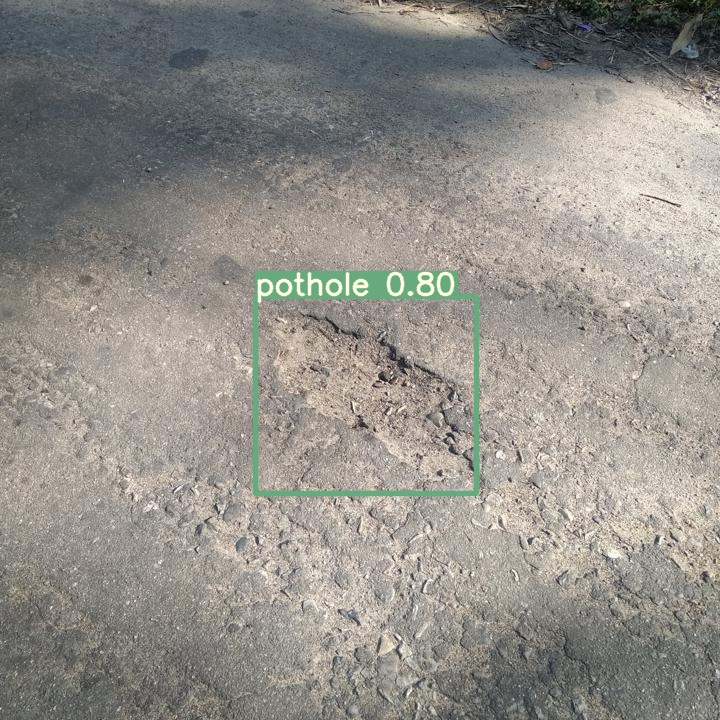

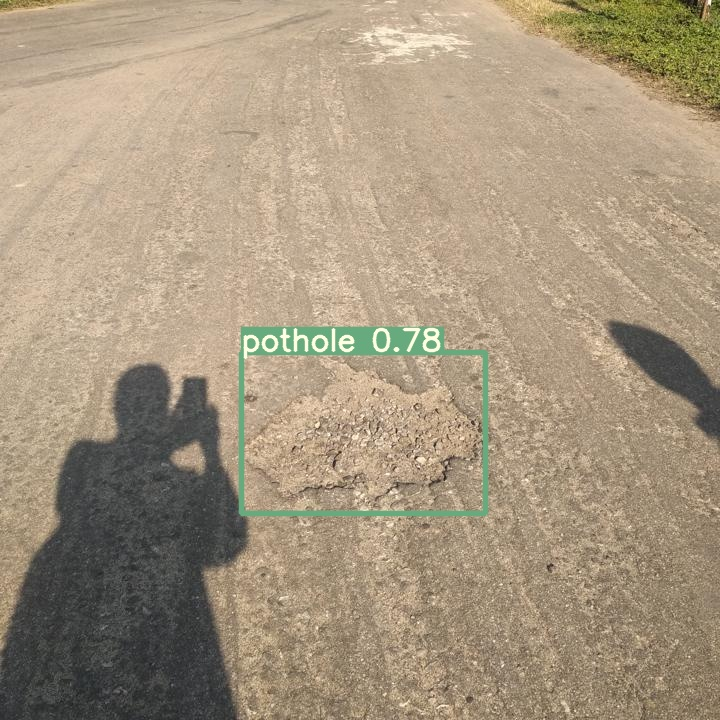

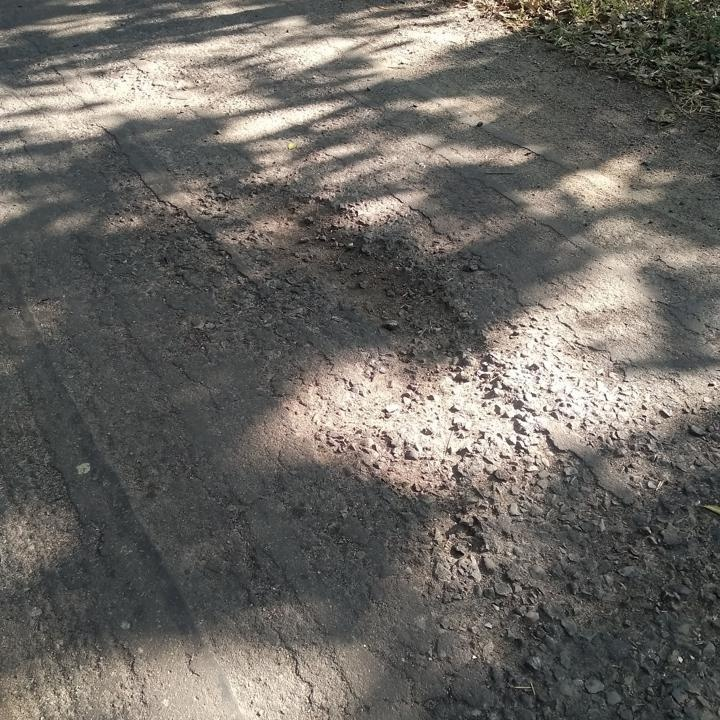

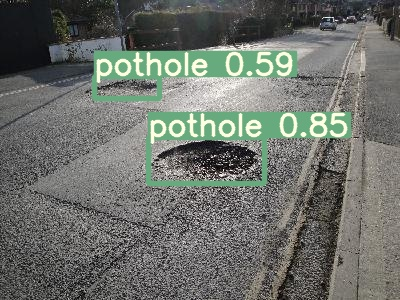

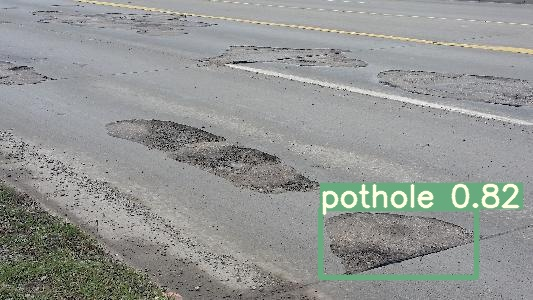

...

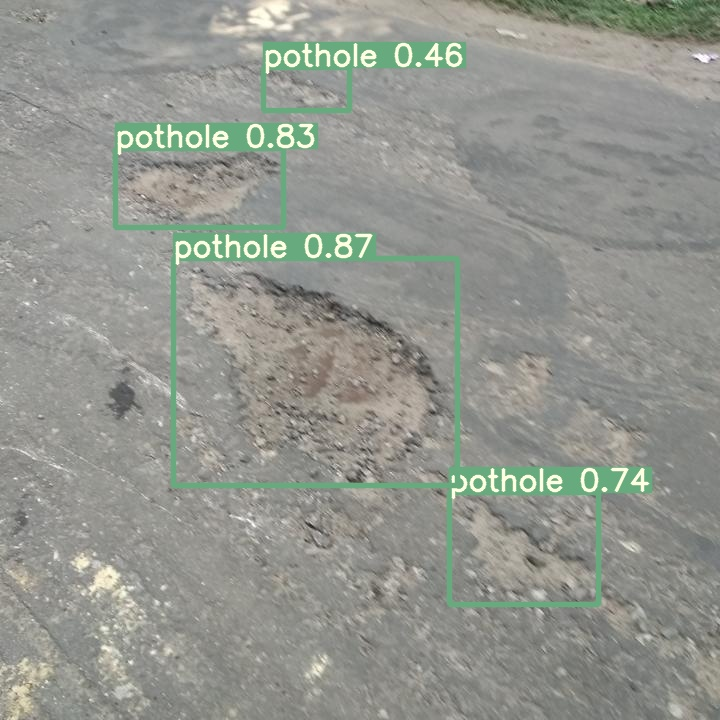

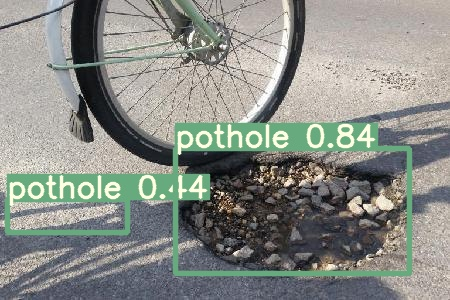

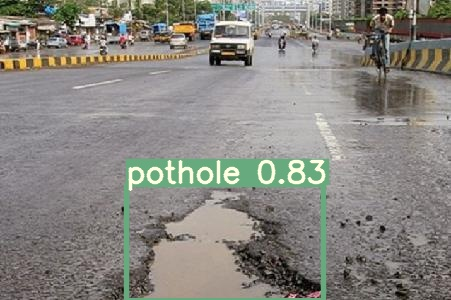

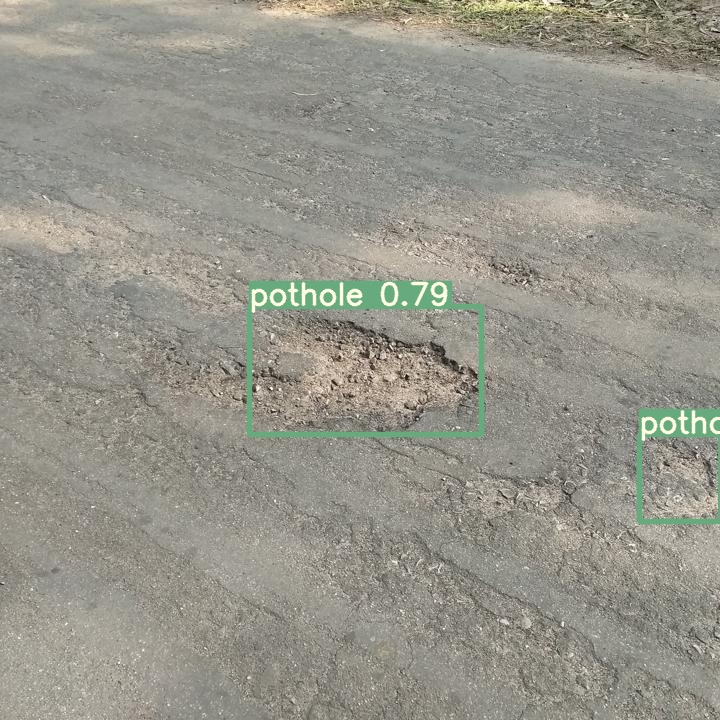

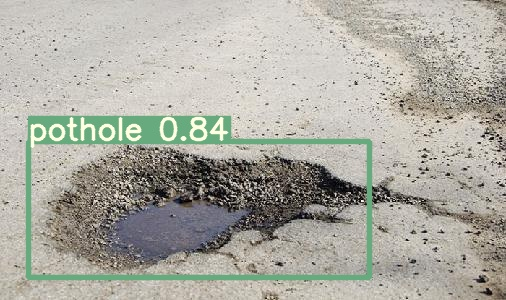

In [ ]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Export Trained Weights for Future Inference

Now that you have trained your custom detector, you can export the trained weights you have made here for inference on your device elsewhere

In [ ]:
%cd /content/easyreport
!git config --global user.email '$ename'
!git config --global user.name '$uname'

!git add pothole_detection/weights/best.pt
!git commit -m 'weights'  # commit in Colab
!git push

Counting objects: 24, done.
Delta compression using up to 2 threads.
Compressing objects: 100% (23/23), done.
Writing objects: 100% (24/24), 12.69 MiB | 10.01 MiB/s, done.
Total 24 (delta 5), reused 0 (delta 0)
remote: Resolving deltas: 100% (5/5), completed with 4 local objects.
To https://github.com/reapbenefit/easyreport.git
   9593eba..093d54f  main -> main
